In [1]:
import tensorflow as tf
import numpy as np
from time import time
from utils import plot_images, print_progress, read_mnist_data, add_variable_histogram_summaries, merge, interpolate
from os.path import exists
from glob import glob
import scipy

In [2]:
class Data(object):
    def __init__(self, file_path):
        self.files = glob(file_path)
        self.num_examples = len(self.files)
        
    def next_batch(self, batch_size, batch_id=None):
        if batch_id is None:
            batch_idx = np.random.randint(0, self.num_examples, batch_size)
        else:
            batch_idx = np.arange(batch_id * batch_size, min((batch_id+1) * batch_size, self.num_examples))
            
        images = []
        for i in batch_idx:
            images.append(scipy.misc.imread(self.files[i]) / 127.5 - 1)
        
        return np.stack(images)

data = Data('data/celebB/*.jpg')

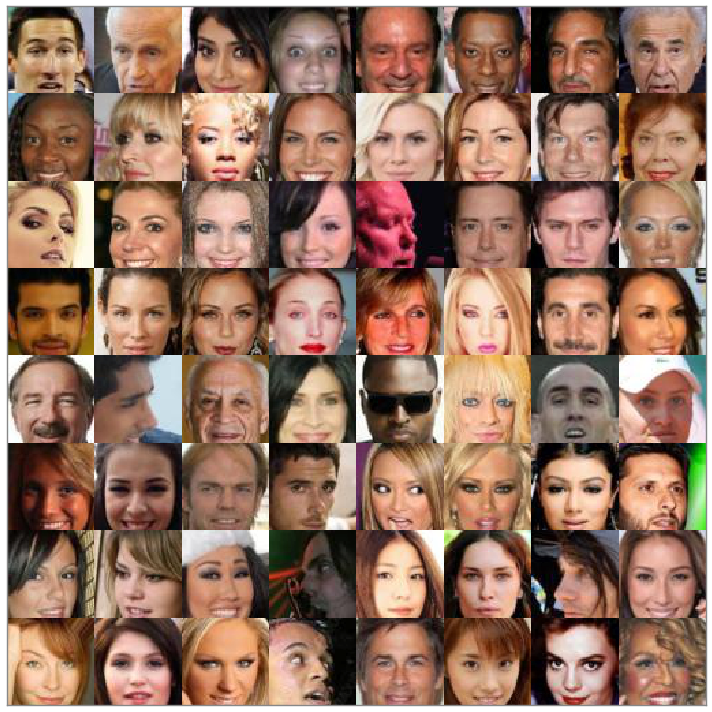

In [4]:
plot_images(merge((data.next_batch(64) + 1) / 2))

In [3]:
def lrelu(x, leak=0.2, name="lrelu"):
    return tf.maximum(x, leak*x)

In [4]:
def generator(z, cat, cont, training):
    x_gen = tf.layers.dense(tf.concat([z, cat, cont], 1), 4 * 4 * 512, kernel_initializer=tf.random_normal_initializer(stddev=0.02), name='fc1')
    x_gen = tf.reshape(x_gen, (-1, 4, 4, 512))
    x_gen = tf.contrib.layers.batch_norm(x_gen, decay=0.9, updates_collections=None, epsilon=1e-5, scale=True, is_training=training, scope='bn1')
    x_gen = tf.nn.relu(x_gen)
    
    x_gen = tf.layers.conv2d_transpose(x_gen, 256, (5, 5), (2, 2), kernel_initializer=tf.random_normal_initializer(stddev=0.02), padding='same', name='tconv1')
    x_gen = tf.contrib.layers.batch_norm(x_gen, decay=0.9, updates_collections=None, epsilon=1e-5, scale=True, is_training=training, scope='bn2')
    x_gen = tf.nn.relu(x_gen)
    
    x_gen = tf.layers.conv2d_transpose(x_gen, 128, (5, 5), (2, 2), kernel_initializer=tf.random_normal_initializer(stddev=0.02), padding='same', name='tconv2')
    x_gen = tf.contrib.layers.batch_norm(x_gen, decay=0.9, updates_collections=None, epsilon=1e-5, scale=True, is_training=training, scope='bn3')
    x_gen = tf.nn.relu(x_gen)
    
    x_gen = tf.layers.conv2d_transpose(x_gen, 64, (5, 5), (2, 2), kernel_initializer=tf.random_normal_initializer(stddev=0.02), padding='same', name='tconv3')
    x_gen = tf.contrib.layers.batch_norm(x_gen, decay=0.9, updates_collections=None, epsilon=1e-5, scale=True, is_training=training, scope='bn4')
    x_gen = tf.nn.relu(x_gen)
    
    x_gen = tf.layers.conv2d_transpose(x_gen, 3, (5, 5), (2, 2), kernel_initializer=tf.random_normal_initializer(stddev=0.02), padding='same', name='tconv4')
    return tf.nn.tanh(x_gen)

In [5]:
def discriminator(img, training):
    p = tf.layers.conv2d(img, 64, (5, 5), strides=(2, 2), kernel_initializer=tf.random_normal_initializer(stddev=0.02), padding='same', name='conv1')
    p = lrelu(p, 0.2, 'lrelu1')
    
    p = tf.layers.conv2d(p, 128, (5, 5), strides=(2, 2), kernel_initializer=tf.random_normal_initializer(stddev=0.02), padding='same', name='conv2')
    p = tf.contrib.layers.batch_norm(p, decay=0.9, updates_collections=None, epsilon=1e-5, scale=True, is_training=training, scope='bn1')
    p = lrelu(p, 0.2, 'lrelu2')
    
    p = tf.layers.conv2d(p, 256, (5, 5), strides=(2, 2), kernel_initializer=tf.random_normal_initializer(stddev=0.02), padding='same', name='conv3')
    p = tf.contrib.layers.batch_norm(p, decay=0.9, updates_collections=None, epsilon=1e-5, scale=True, is_training=training, scope='bn2')
    p = lrelu(p, 0.2, 'lrelu3')
    
    p = tf.layers.conv2d(p, 512, (5, 5), strides=(2, 2), kernel_initializer=tf.random_normal_initializer(stddev=0.02), padding='same', name='conv4')
    p = tf.contrib.layers.batch_norm(p, decay=0.9, updates_collections=None, epsilon=1e-5, scale=True, is_training=training, scope='bn3')
    p = lrelu(p, 0.2, 'lrelu4')
    
    disc_out = tf.reshape(p, (-1, 4 * 4 * 512))
    p = tf.layers.dense(disc_out, 1, kernel_initializer=tf.random_normal_initializer(stddev=0.02), name='fc1')
    return p, disc_out

In [6]:
def Q(x, cont_dim):
    q = tf.layers.dense(x, 1024, activation=tf.nn.relu, kernel_initializer=tf.random_normal_initializer(stddev=0.02), name='fc1')
    cat = tf.layers.dense(q, 10, activation=tf.nn.softmax, kernel_initializer=tf.random_normal_initializer(stddev=0.02), name='fc2')
    cont_mean = tf.layers.dense(q, cont_dim, kernel_initializer=tf.random_normal_initializer(stddev=0.02), name='fc3')
    cont_neg_ln_std = tf.layers.dense(q, cont_dim, kernel_initializer=tf.random_normal_initializer(stddev=0.02), name='fc4')
    return cat, cont_mean, cont_neg_ln_std

In [7]:
z_dim = 0
cont_dim = 100

tf.reset_default_graph()

with tf.name_scope('inputs'):
    x = tf.placeholder(tf.float32, (None, 64, 64, 3), 'x')
    z = tf.placeholder(tf.float32, (None, z_dim), 'z')
    training = tf.placeholder(tf.bool, name='training')
    cat = tf.placeholder(tf.float32, (None, 10), 'cat')
    cont = tf.placeholder(tf.float32, (None, cont_dim), 'cont')
    
with tf.variable_scope('generator'):
    x_gen = generator(z, cat, cont, training) 
    
with tf.variable_scope('discriminator'):
    l_x, _ = discriminator(x, training)
    tf.get_variable_scope().reuse_variables()
    l_g, disc_out = discriminator(x_gen, training)
    
with tf.variable_scope('Q'):
    q_cat, q_cont_mean, q_cont_neg_ln_std = Q(disc_out, cont_dim)
    
with tf.name_scope('optimizer'):
    loss_g = tf.reduce_mean(tf.nn.sigmoid_cross_entropy_with_logits(logits=l_g, labels=tf.ones_like(l_g)))
    loss_d = tf.reduce_mean(tf.nn.sigmoid_cross_entropy_with_logits(logits=l_x, labels=tf.ones_like(l_x))) + tf.reduce_mean(tf.nn.sigmoid_cross_entropy_with_logits(logits=l_g, labels=tf.zeros_like(l_g)))
    loss_q_cat = -tf.reduce_mean(tf.reduce_sum(tf.log(q_cat + 1e-8) * cat, 1)) - tf.reduce_mean(tf.reduce_sum(tf.log(cat + 1e-8) * cat, 1))
    loss_q_cont = tf.reduce_mean(tf.reduce_sum(0.5 * (cont - q_cont_mean)**2 * tf.exp(q_cont_neg_ln_std) - 0.5 * q_cont_neg_ln_std, axis=1) + 0.5 * tf.log(2 * np.pi) * cont_dim)
    loss_q = loss_q_cat + 1e-1 * loss_q_cont
    optimizer_g = tf.train.AdamOptimizer(2e-4, 0.5)
    grads_g = optimizer_g.compute_gradients(loss_g, var_list=tf.get_collection(tf.GraphKeys.TRAINABLE_VARIABLES, 'generator'))
    optimize_g = optimizer_g.apply_gradients(grads_g)
    optimizer_d = tf.train.AdamOptimizer(2e-4, 0.5)
    grads_d = optimizer_d.compute_gradients(loss_d, var_list=tf.get_collection(tf.GraphKeys.TRAINABLE_VARIABLES, 'discriminator'))
    optimize_d = optimizer_d.apply_gradients(grads_d)
    optimize_q = tf.train.AdamOptimizer(2e-4, 0.5).minimize(loss_q, var_list=tf.get_collection(tf.GraphKeys.TRAINABLE_VARIABLES, 'Q') + tf.get_collection(tf.GraphKeys.TRAINABLE_VARIABLES, 'generator'))
    
tf.summary.scalar('loss_g', loss_g)
tf.summary.scalar('loss_d', loss_d)
tf.summary.scalar('loss_q_cat', loss_q_cat)
tf.summary.scalar('loss_q_cont', loss_q_cont)
add_variable_histogram_summaries()

for g_v_pair in grads_g:
    if not (g_v_pair[0] is None):
        tf.summary.histogram('grad-' + g_v_pair[1].name, g_v_pair[0])
        
for g_v_pair in grads_d:
    if not (g_v_pair[0] is None):
        tf.summary.histogram('grad-' + g_v_pair[1].name, g_v_pair[0])
        
summ = tf.summary.merge_all()

saver = tf.train.Saver()

INFO:tensorflow:Summary name generator/fc1/kernel:0 is illegal; using generator/fc1/kernel_0 instead.
INFO:tensorflow:Summary name generator/fc1/bias:0 is illegal; using generator/fc1/bias_0 instead.
INFO:tensorflow:Summary name generator/bn1/beta:0 is illegal; using generator/bn1/beta_0 instead.
INFO:tensorflow:Summary name generator/bn1/gamma:0 is illegal; using generator/bn1/gamma_0 instead.
INFO:tensorflow:Summary name generator/tconv1/kernel:0 is illegal; using generator/tconv1/kernel_0 instead.
INFO:tensorflow:Summary name generator/tconv1/bias:0 is illegal; using generator/tconv1/bias_0 instead.
INFO:tensorflow:Summary name generator/bn2/beta:0 is illegal; using generator/bn2/beta_0 instead.
INFO:tensorflow:Summary name generator/bn2/gamma:0 is illegal; using generator/bn2/gamma_0 instead.
INFO:tensorflow:Summary name generator/tconv2/kernel:0 is illegal; using generator/tconv2/kernel_0 instead.
INFO:tensorflow:Summary name generator/tconv2/bias:0 is illegal; using generator/tco

In [8]:
nb_name = 'InfoGAN-celebA-Saturated'
path_out = 'output/' + nb_name + '/'
path_chk = 'checkpoints/' + nb_name + '/' + nb_name
path_chk_data = 'checkpoints/' + nb_name + '/' + nb_name + '.data-00000-of-00001'
path_writer = 'checkpoints/' + nb_name

In [9]:
def plot_generated_images(sess, latent=None, label=None, cont_latent=None, save_name=None):
    if latent is None:
        if label is None:
            latent = np.random.uniform(-1, 1, (11, z_dim))
            labels = np.random.multinomial(1, [0.1]*10, len(latent))
        elif len(label) == 1:
            labels = np.zeros((11, 10))
            labels[range(11), label[0]] = 1
        else:
            labels = label
            latent = np.random.uniform(-1, 1, (len(label), z_dim))
    else:
        if label is None:
            labels = np.random.multinomial(1, [0.1]*10, len(latent))
        elif len(label) == 1:
            labels = np.zeros((len(latent), 10))
            labels[range(len(latent)), label[0]] = 1
        else:
            labels = label
            
    if cont_latent is None:
        cont_latent = np.random.uniform(-1, 1, (len(latent), cont_dim))
        
    generated_images = sess.run(x_gen, feed_dict={cat: labels, z: latent, cont: cont_latent, training:False})
    
    if label is None:
        plot_images((generated_images + 1) / 2, np.argmax(labels, 1))
    else:
        plot_images(merge((generated_images + 1) / 2))
    
    if save_name is not None:
        scipy.misc.imsave(path_out + save_name + '.jpg', merge((generated_images + 1) / 2)[0, :, :, :])

In [10]:
batch_size = 64
plots_per_epoch = 5

batches_per_epoch = int(data.num_examples / batch_size)

config = tf.ConfigProto()
config.gpu_options.allow_growth = True

def optimize(epochs=1):
    start_time = time()
    
    writer = tf.summary.FileWriter(path_writer, tf.get_default_graph())
    
    with tf.Session(config=config) as sess:
        if exists(path_chk_data):
            saver.restore(sess, path_chk)
        else:
            sess.run(tf.global_variables_initializer())
        
        for epoch in range(epochs):
            epoch_start_time = time()
            latent = np.random.uniform(-1, 1, (11, z_dim))
            for batch in range(batches_per_epoch):
                x_batch = data.next_batch(batch_size, batch)
                z_batch = np.random.uniform(-1, 1, (batch_size, z_dim))
                cat_batch = np.random.multinomial(1, [0.1]*10, batch_size)
                cont_batch = np.random.uniform(-1, 1, (batch_size, cont_dim))
                feed_dict_train = {x: x_batch, cat: cat_batch, z: z_batch, cont: cont_batch, training: True}
                for _ in range(1):
                    sess.run(optimize_d, feed_dict_train)
                for _ in range(2):
                    sess.run(optimize_g, feed_dict_train)
                for _ in range(1):
                    sess.run(optimize_q, feed_dict_train)

                if (epoch * batches_per_epoch + batch) % 100 == 0:
                    writer.add_summary(sess.run(summ, feed_dict_train), global_step=epoch * batches_per_epoch + batch)
                    
                if batch % int(np.ceil(batches_per_epoch / plots_per_epoch)) == 0:
                    plot_generated_images(sess, latent)
                    
                print_progress(batch, batches_per_epoch, epoch_start_time)
                
            print("{} / {} ({}%)".format(epoch + 1, epochs, np.round((epoch + 1) / epochs * 100, 2)))
            plot_generated_images(sess)
            
            saver.save(sess, path_chk, write_meta_graph=False)
        
    print("Time taken - {}s".format(np.round(time() - start_time, 2)))
    writer.close()

In [13]:
%mkdir $path_out

INFO:tensorflow:Restoring parameters from checkpoints/InfoGAN-celebA-Saturated/InfoGAN-celebA-Saturated


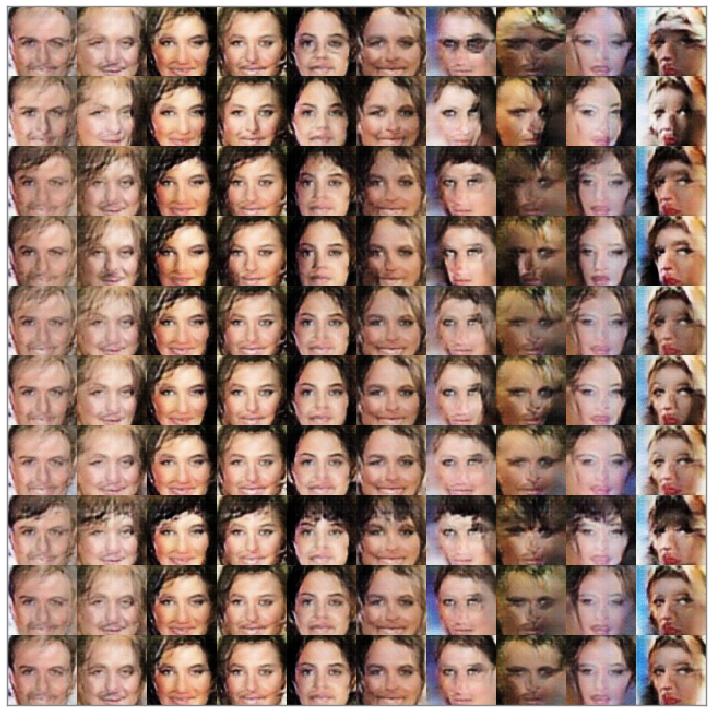

In [14]:
with tf.Session(config=config) as sess:
    if exists(path_chk_data):
        saver.restore(sess, path_chk)
    else:
        sess.run(tf.global_variables_initializer())
        
    latent = np.vstack([np.random.uniform(-1, 1, (10, z_dim))] * 10)
    cont_latent = np.vstack([np.random.uniform(-1, 1, (10, cont_dim))] * 10)
    labels = np.zeros((100, 10))
    for i in range(10):
        labels[i*10:i*10+10, i] = 1
        
    plot_generated_images(sess, latent, labels, cont_latent, save_name='Cat-Sample')

In [11]:
with tf.Session(config=config) as sess:
    if exists(path_chk_data):
        saver.restore(sess, path_chk)
    else:
        sess.run(tf.global_variables_initializer())
        
    mean_cont_info = -sess.run(tf.reduce_mean(0.5 * (cont - q_cont_mean)**2 * tf.exp(q_cont_neg_ln_std) - 0.5 * q_cont_neg_ln_std, 0), {z: np.random.uniform(-1, 1, (1000, z_dim)), cat: np.random.multinomial(1, [0.1]*10, 1000), cont: np.random.uniform(-1, 1, (1000, cont_dim)), training:False})
    
    factors_order = mean_cont_info.argsort()[::-1]
    print(factors_order)

INFO:tensorflow:Restoring parameters from checkpoints/InfoGAN-celebA-Saturated/InfoGAN-celebA-Saturated
[17  4 41 45 68 44 39 49 79 60 52 34 25  3 96  5  7 15 62  2 70 94 91 18 93
 78  9 48 38 16 13 50 86 32 72 67 51 69 77 57 55 56 37 22 85  8 14 21 65 29
 23 71 35 33 64 31 54 26 28  6 19 58 83  1 73 46 20 63  0 40 43 12 84 27 95
 53 74 90 92 89 82 24 98 61 42 81 97 66 75 10 88 59 87 47 36 30 76 80 11 99]


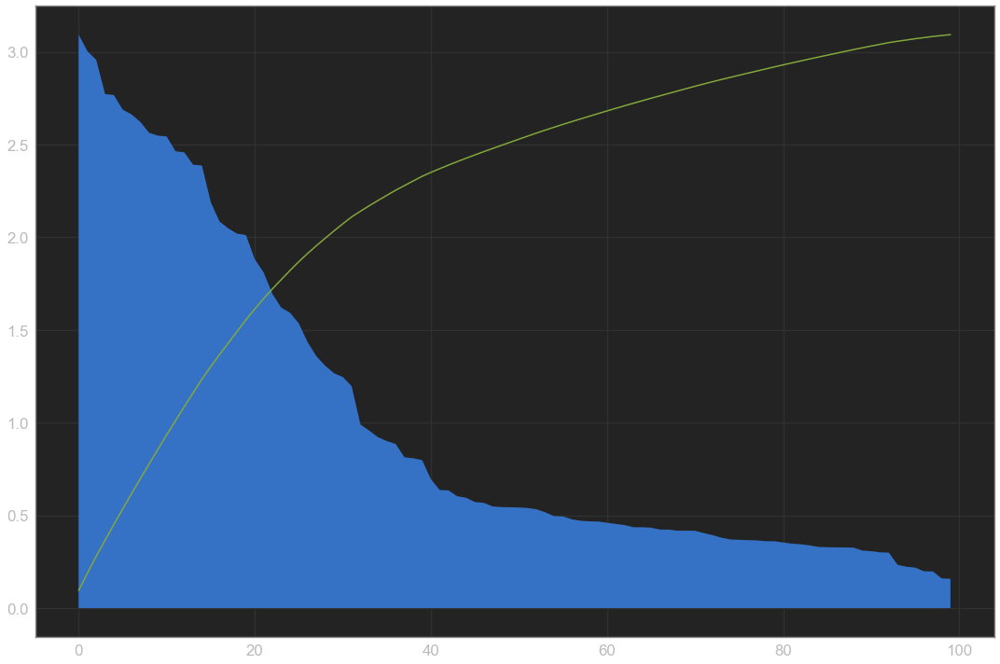

In [12]:
plt.fill_between(range(cont_dim), 0, mean_cont_info[factors_order]/mean_cont_info.sum() * 100)
plt.plot(range(cont_dim), (mean_cont_info[factors_order]/mean_cont_info.sum()).cumsum() * mean_cont_info[factors_order][0] / mean_cont_info.sum() * 100, 'g')
plt.show()

INFO:tensorflow:Restoring parameters from checkpoints/InfoGAN-celebA-Saturated/InfoGAN-celebA-Saturated


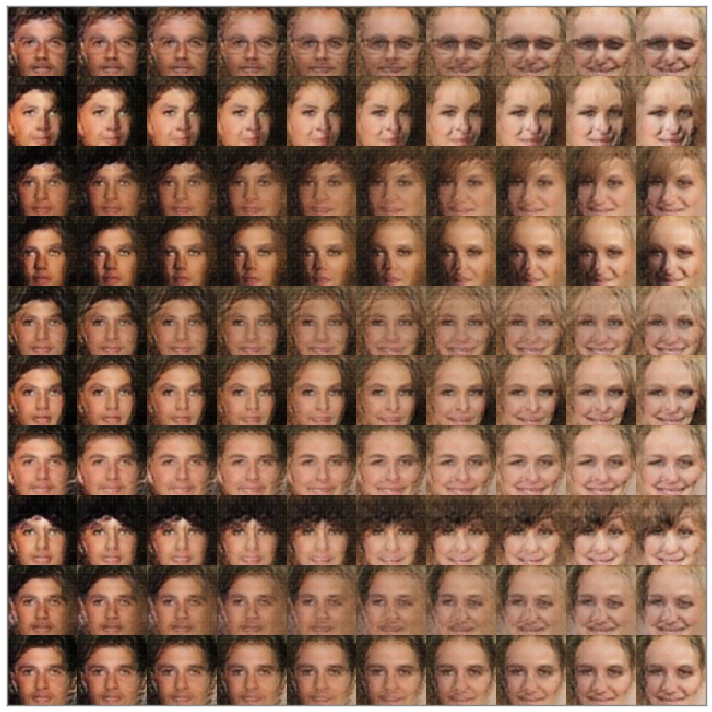

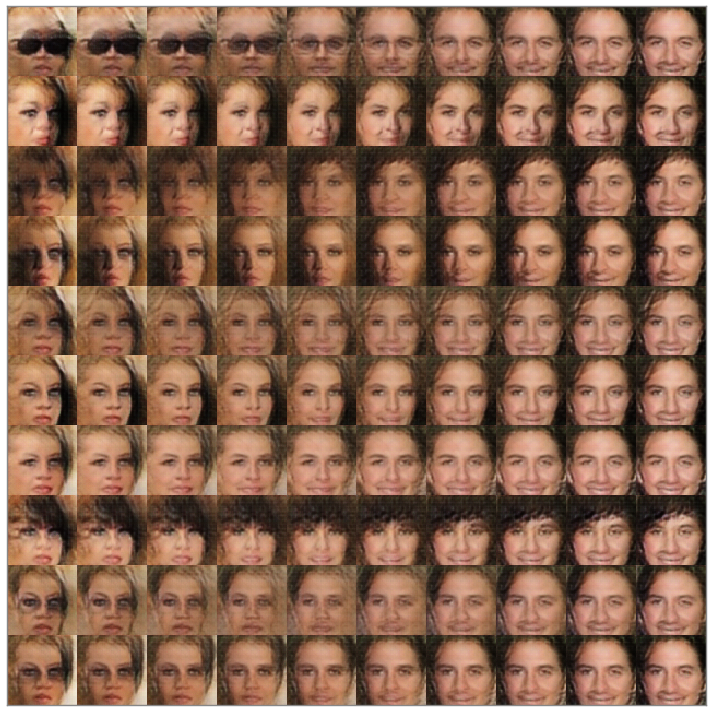

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


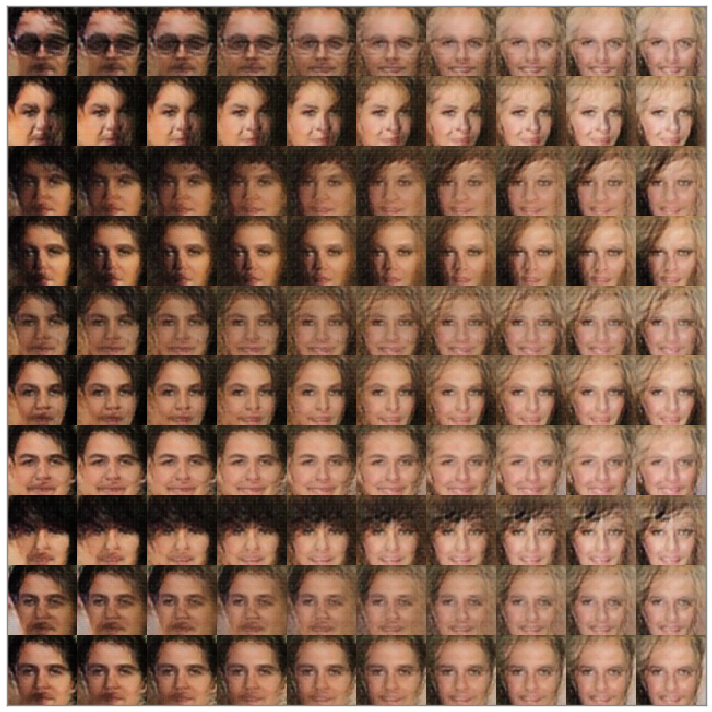

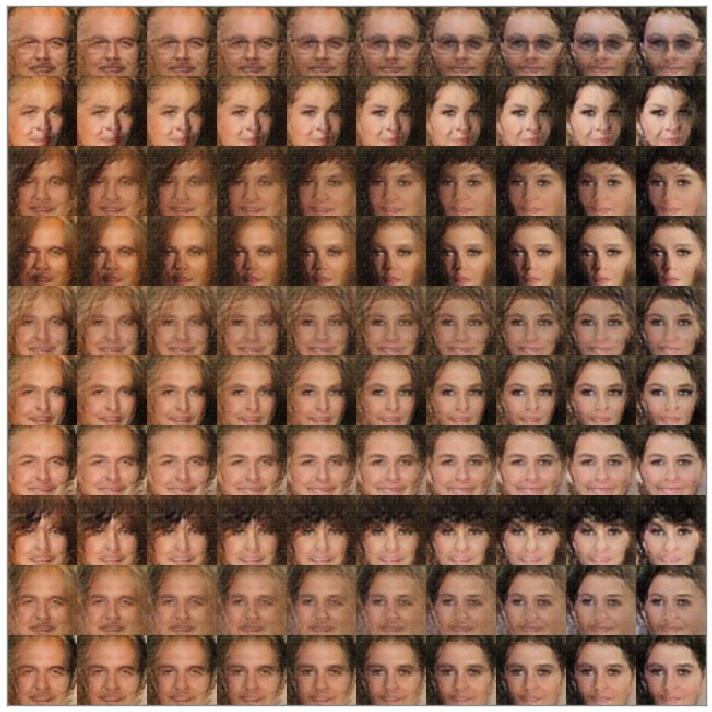

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


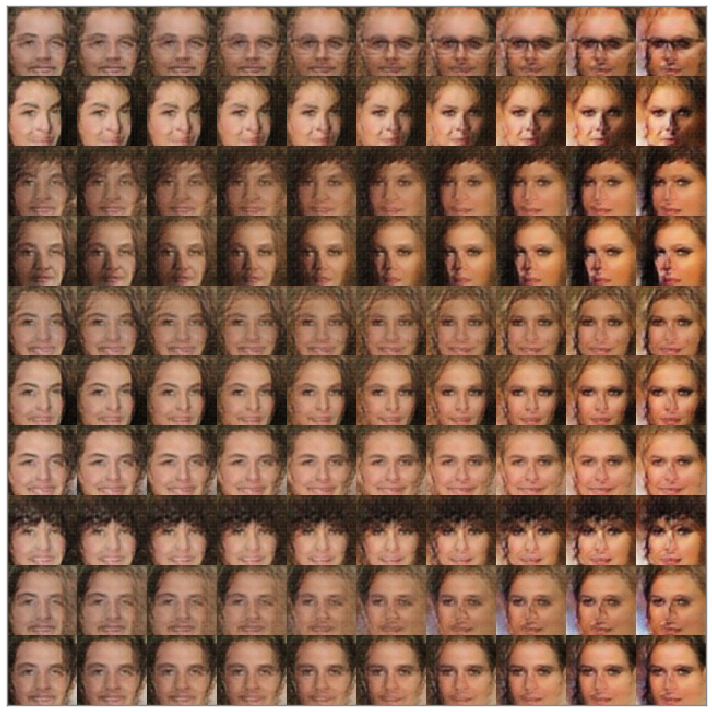

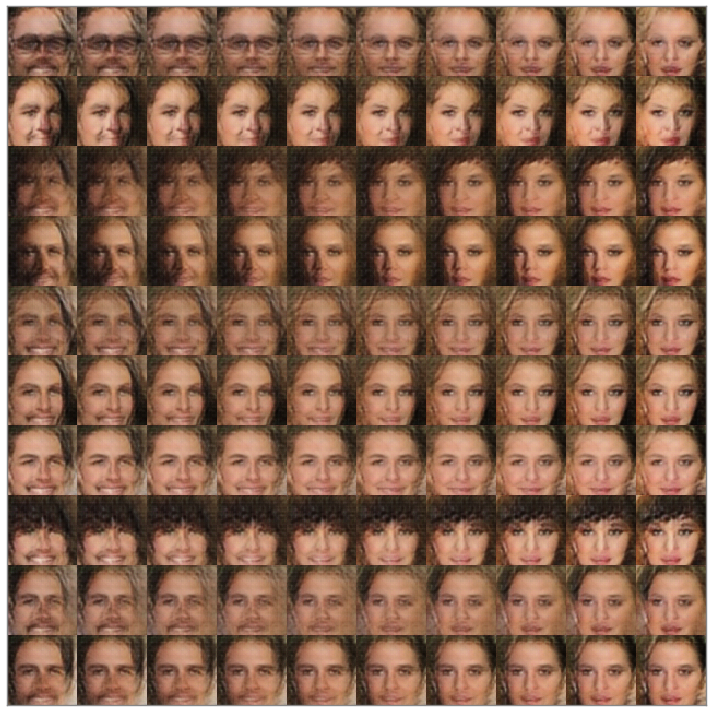

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


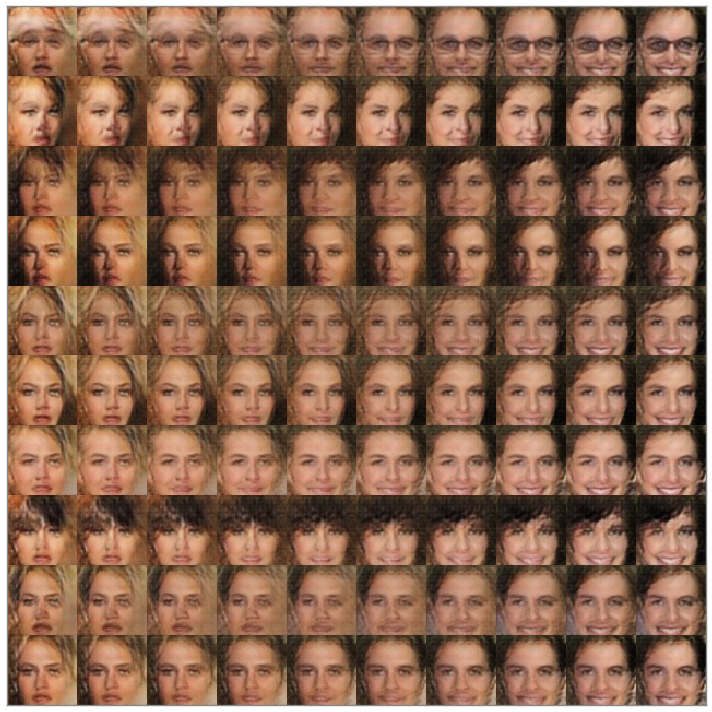

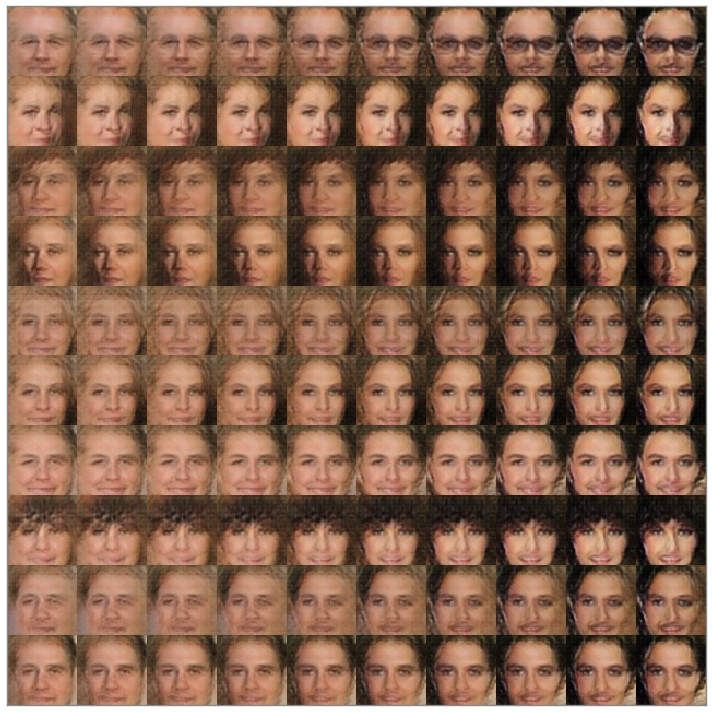

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


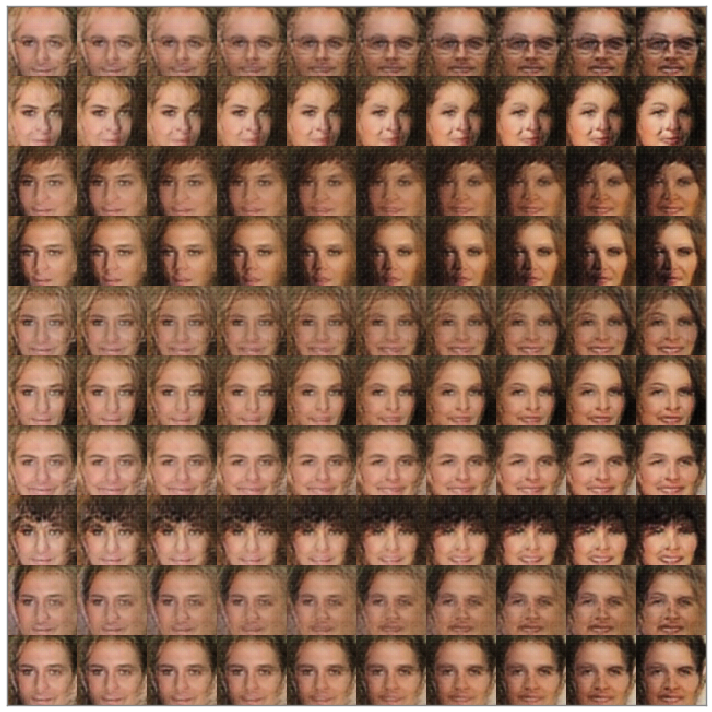

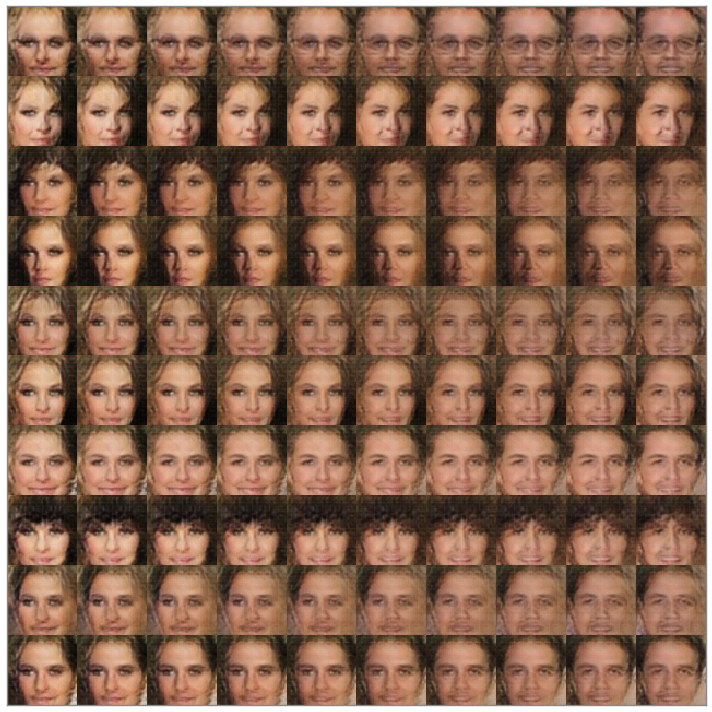

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


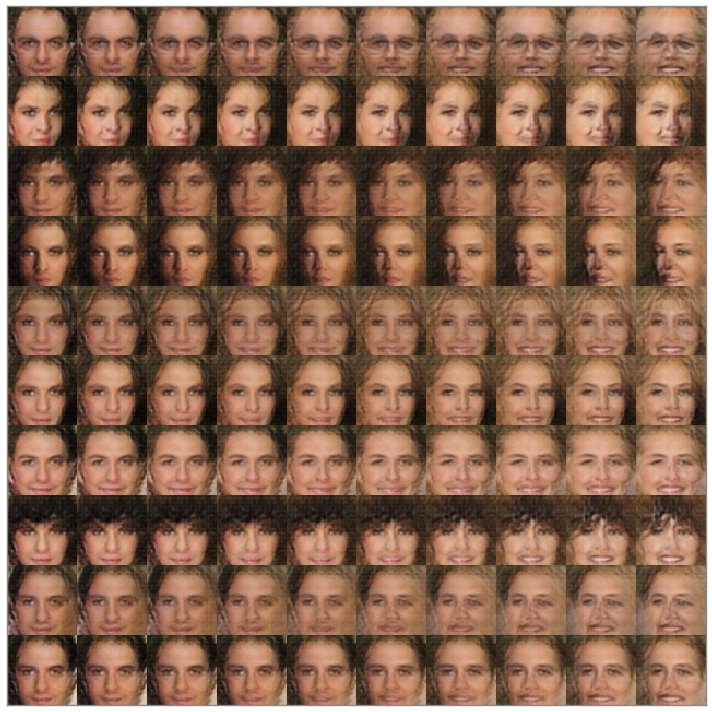

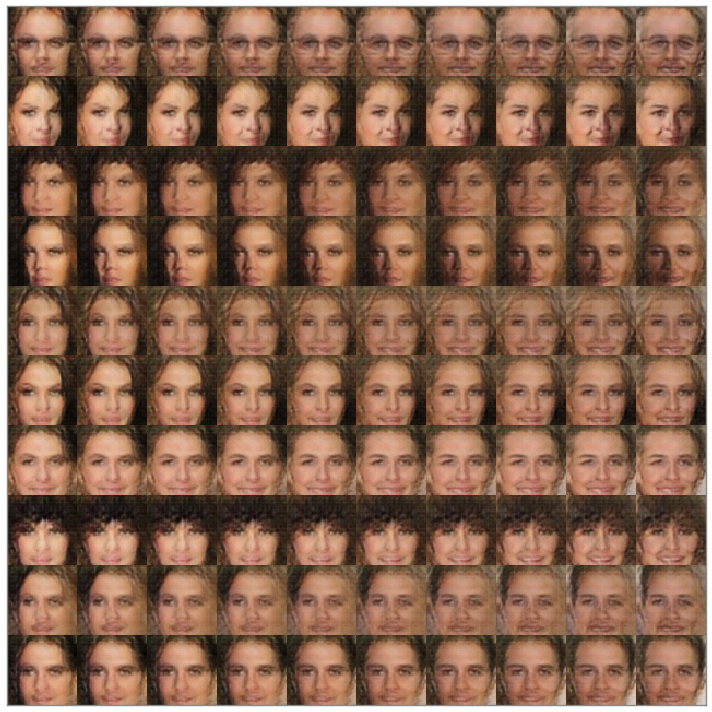

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


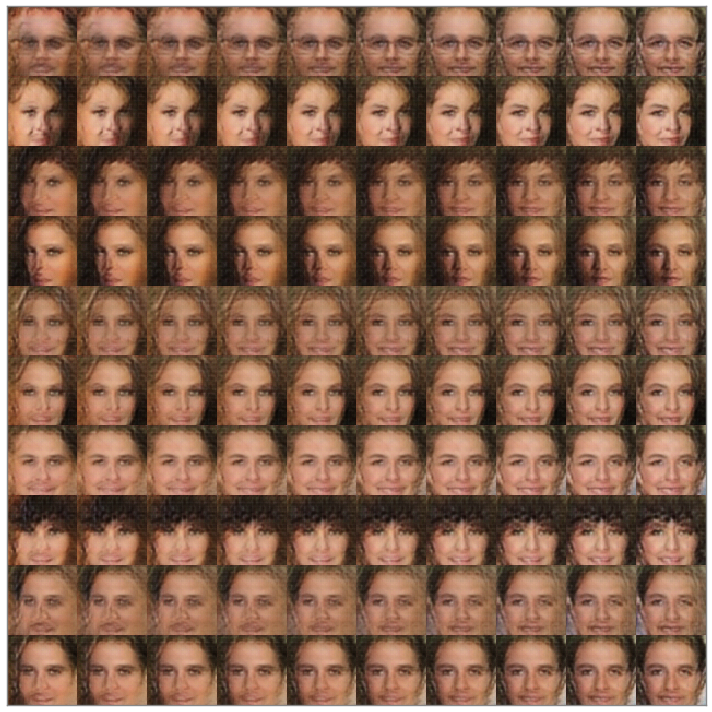

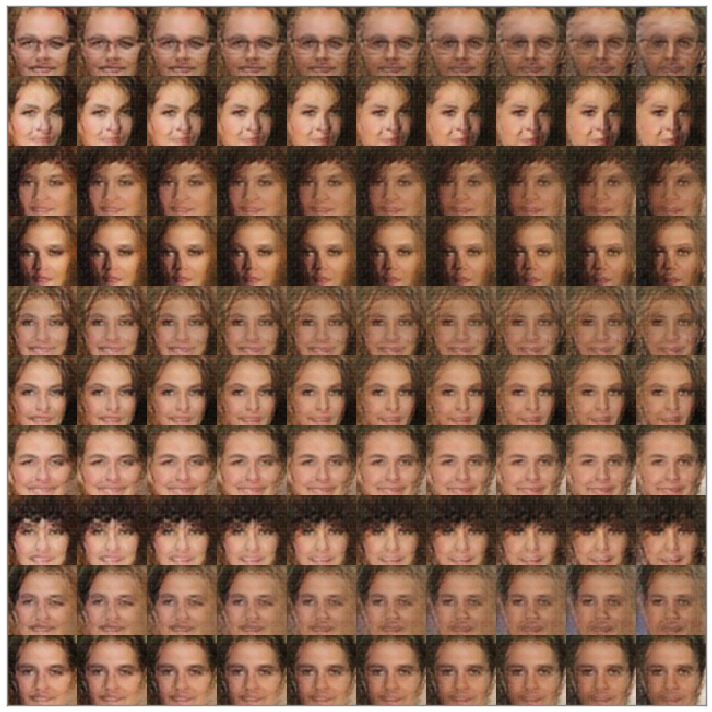

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


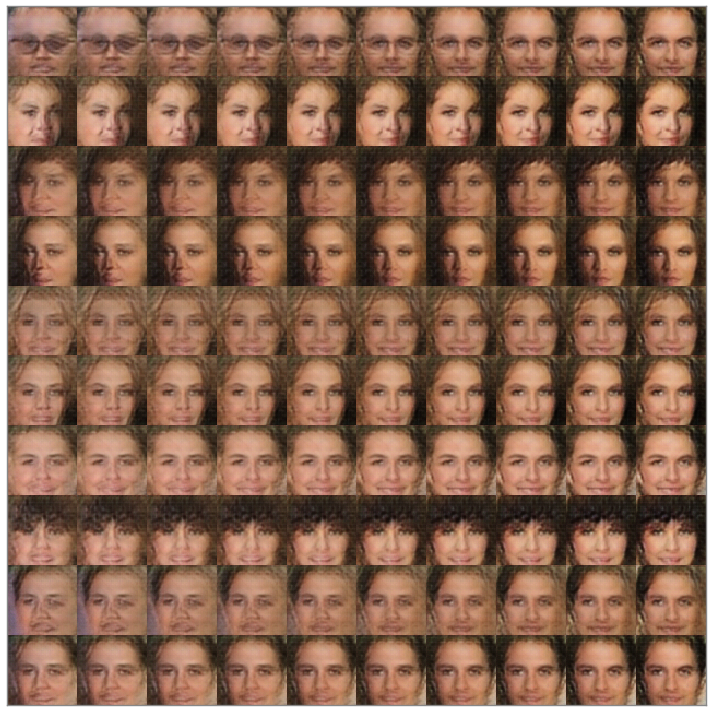

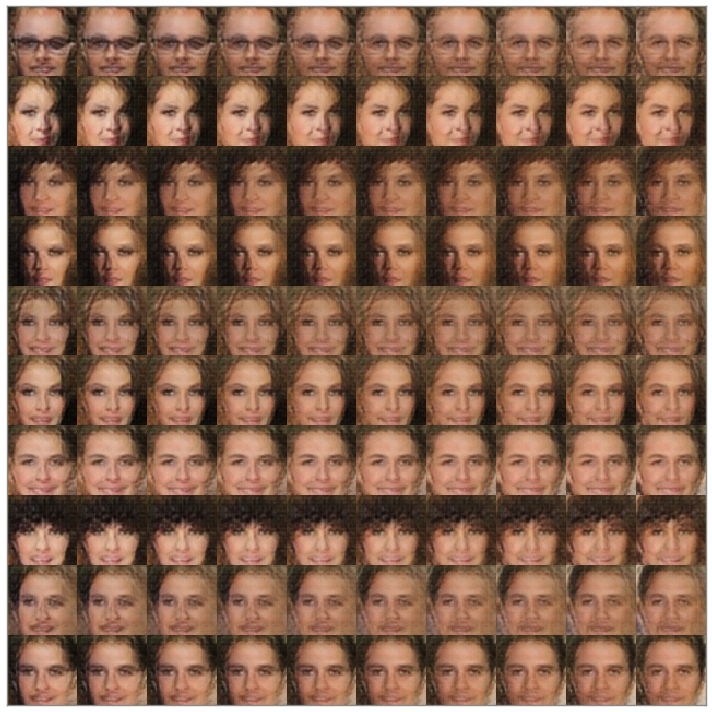

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


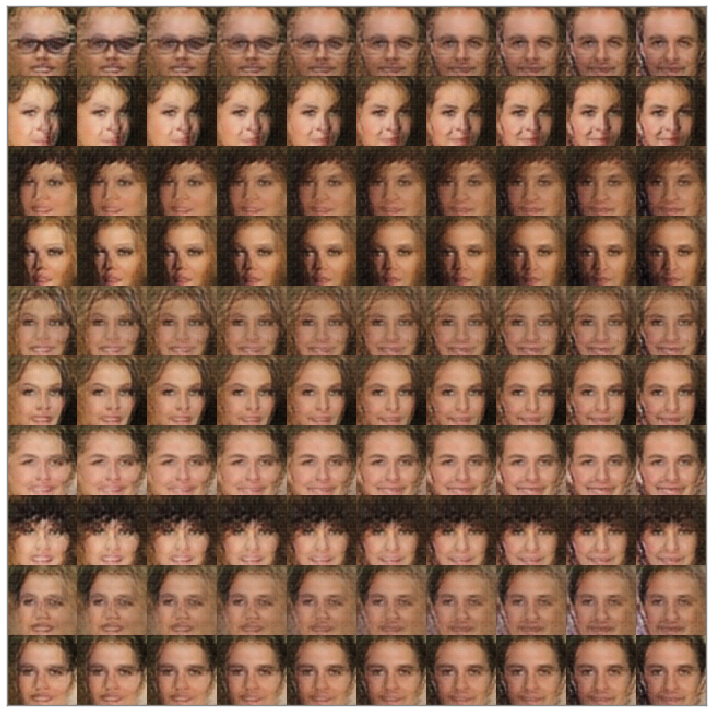

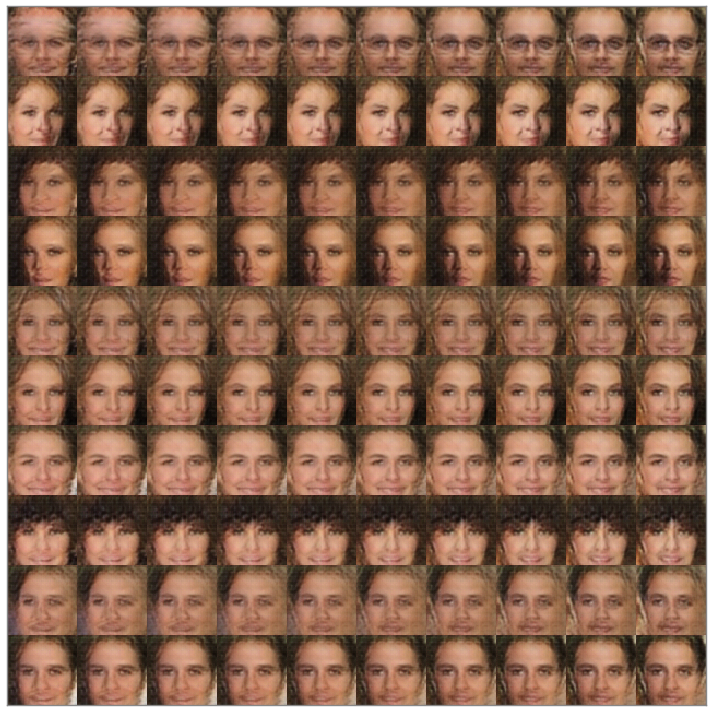

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


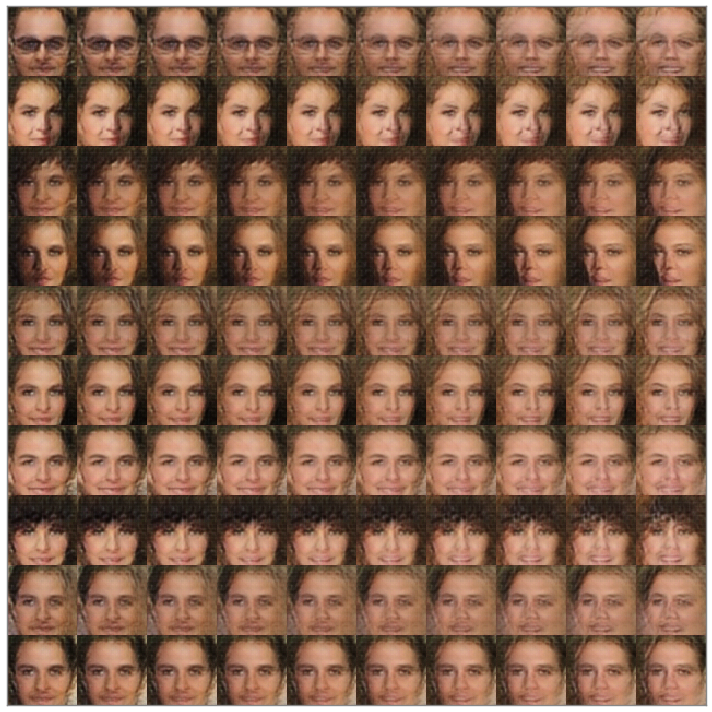

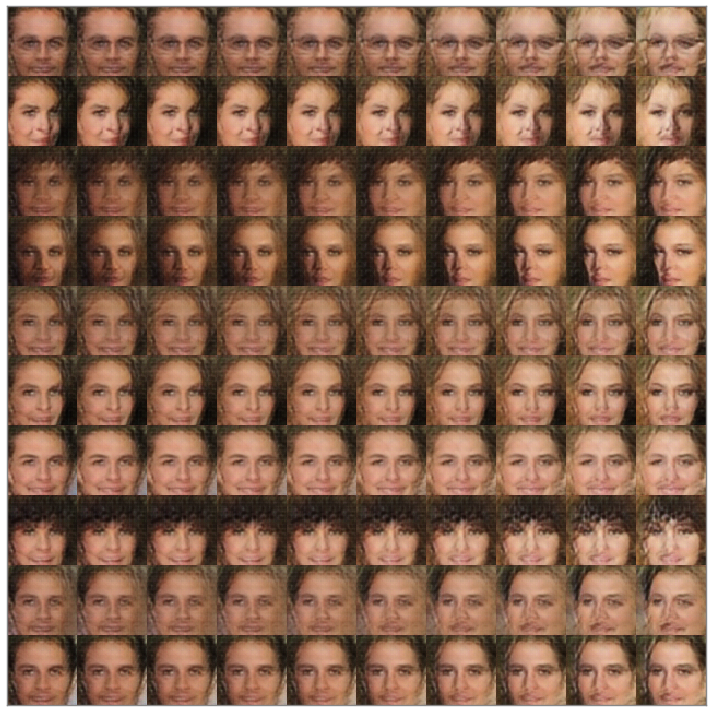

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


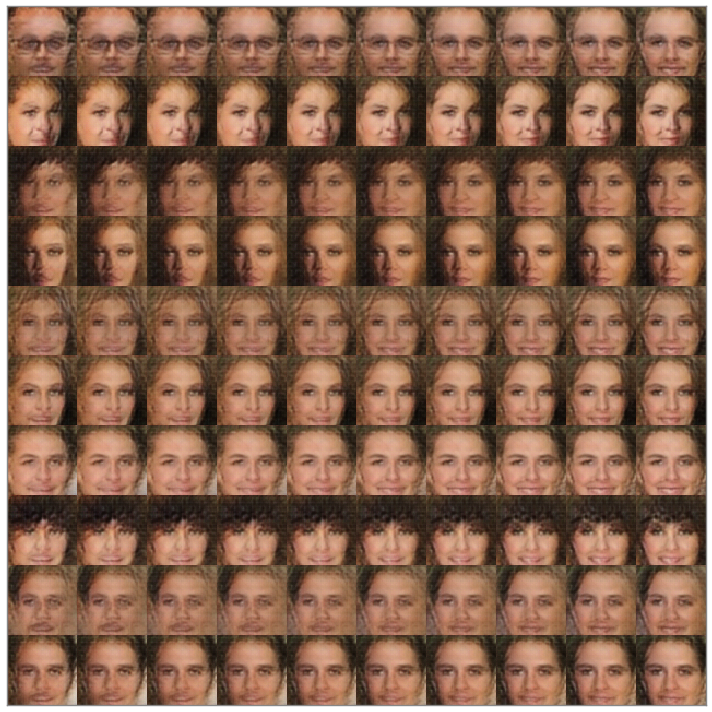

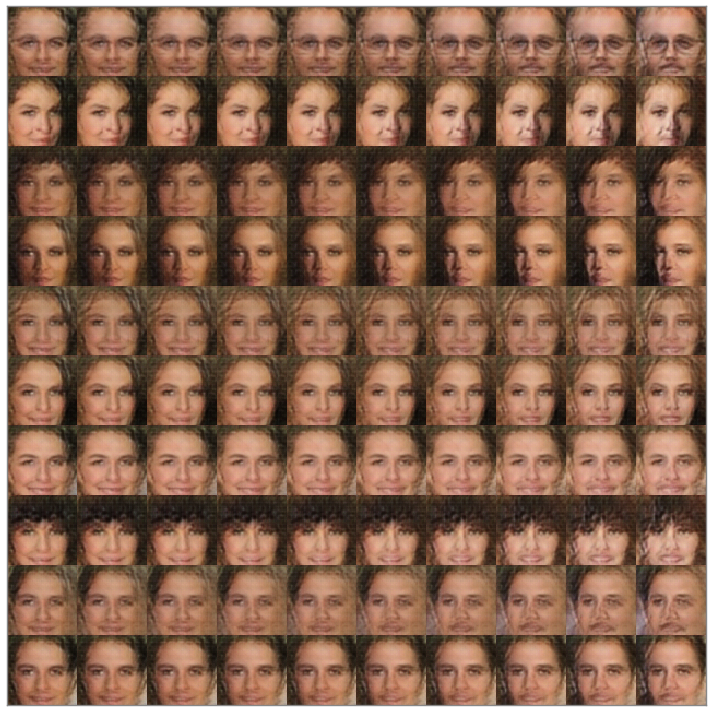

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


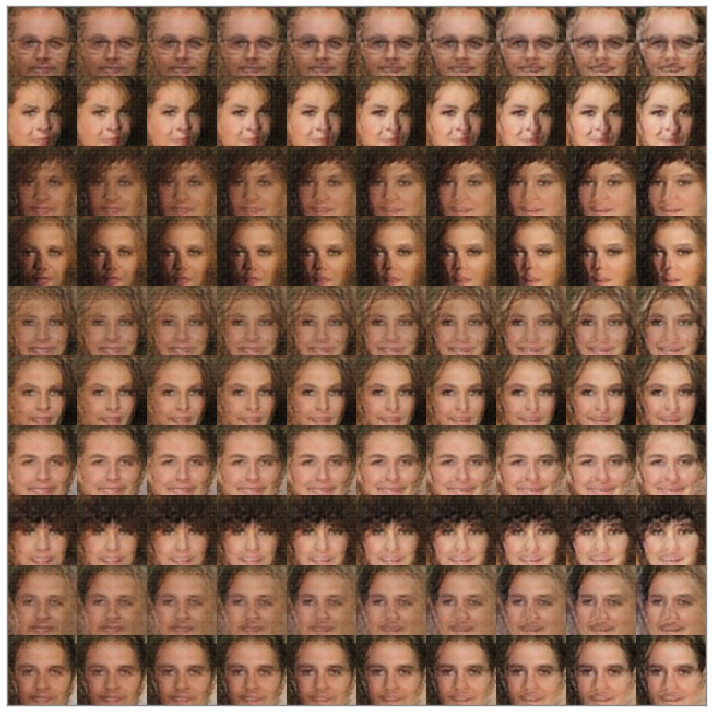

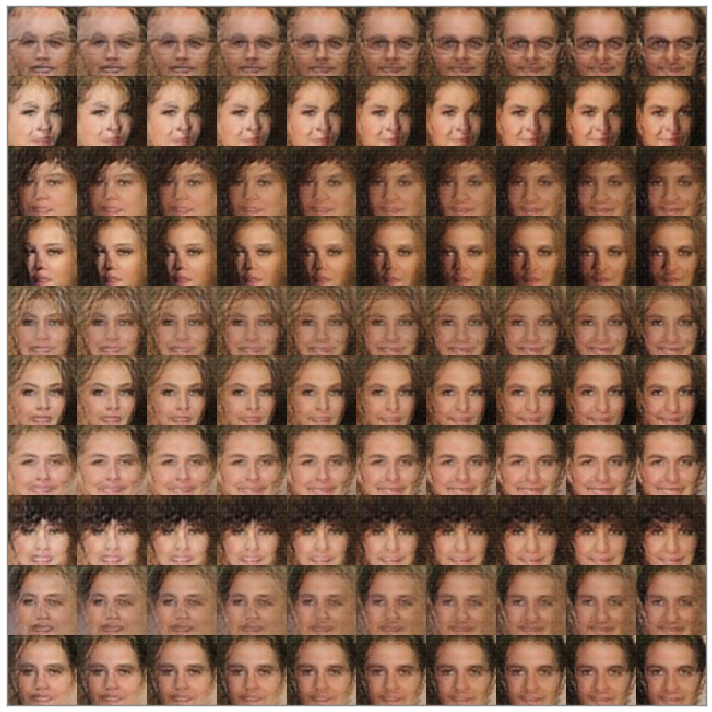

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


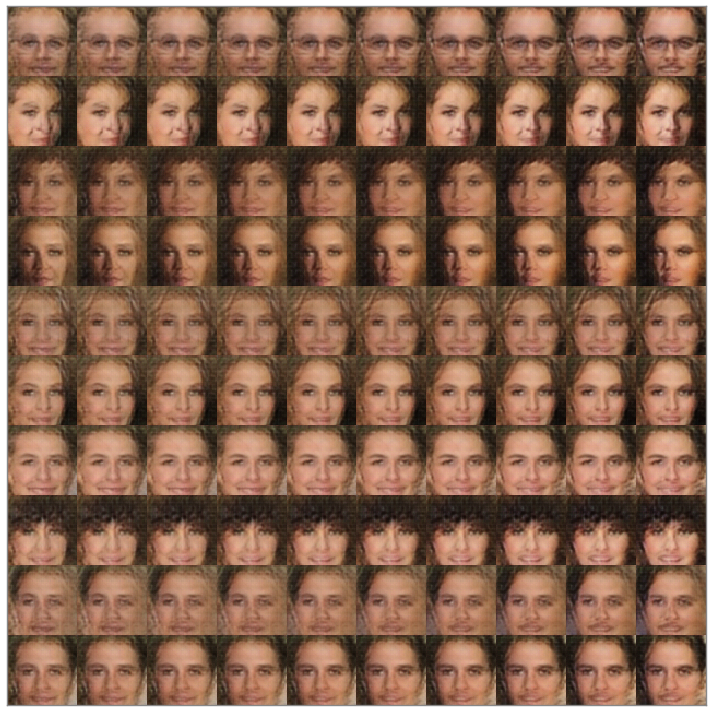

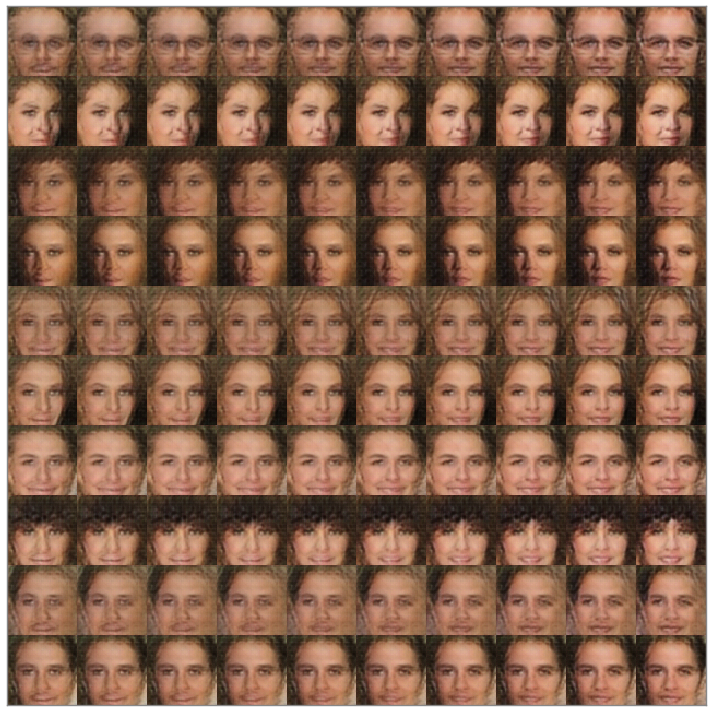

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


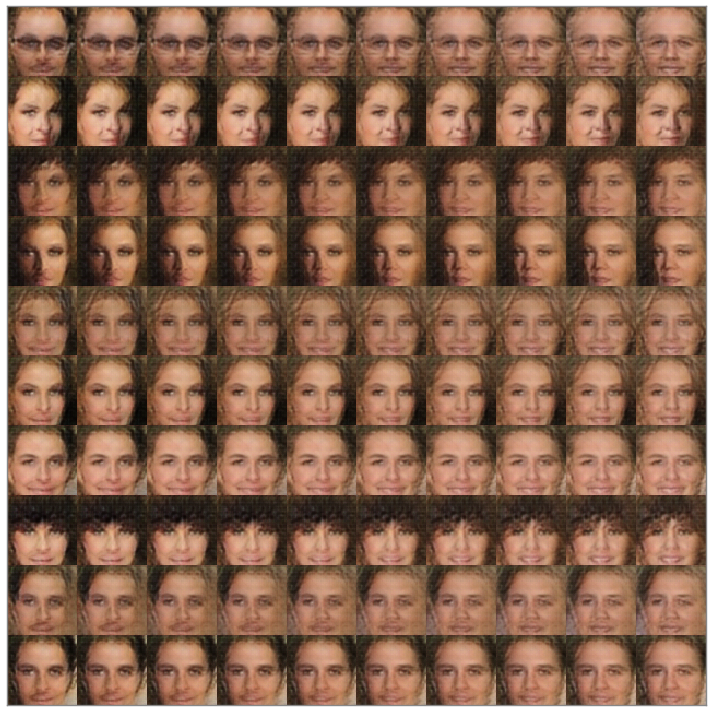

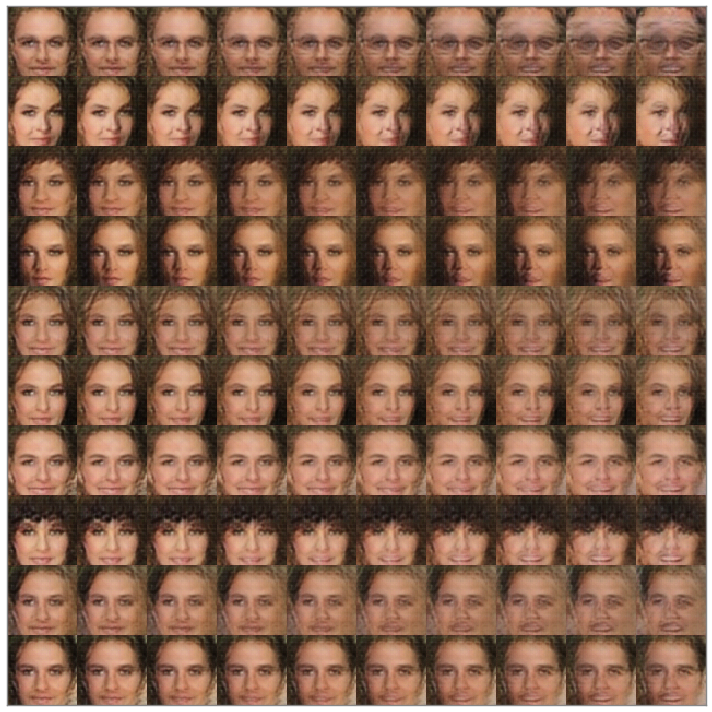

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


In [20]:
with tf.Session(config=config) as sess:
    if exists(path_chk_data):
        saver.restore(sess, path_chk)
    else:
        sess.run(tf.global_variables_initializer())

    for i in range(cont_dim):
        latent = np.vstack([np.random.uniform(-1, 1, (1, z_dim))] * 100)
        labels = np.zeros((100, 10))
        for k in range(10):
            labels[k*10:k*10+10, k] = 1

        cont_latent = np.zeros((100, cont_dim))
        cont_latent[:, factors_order[i]] = np.hstack([np.linspace(-2, 2, 10)] * 10)
        
        plot_generated_images(sess, latent, labels, cont_latent, save_name='Cont' + str(i) + '-Sample')

In [15]:
import imageio
num_points = 300

factor = np.linspace(-2, 2, num_points)
labels = np.zeros((cont_dim, 10))
for k in range(cont_dim):
    labels[k, np.random.randint(0, 10, 1)] = 1
    
with tf.Session(config=config) as sess:
    if exists(path_chk_data):
        saver.restore(sess, path_chk)
    else:
        sess.run(tf.global_variables_initializer())
    
    image_stack = []
    for factor_val in factor:
        latent = np.zeros((cont_dim, z_dim))
        cont_latent = np.zeros((cont_dim, cont_dim))
        for k in range(cont_dim):
            cont_latent[k, factors_order[k]] = factor_val

        generated_images = sess.run(x_gen, feed_dict={cat: labels, z: latent, cont: cont_latent, training:False})
        image_stack.append(merge(generated_images * 0.5 + 0.5))
        
imageio.mimsave(path_out + 'Variation.gif', np.vstack(image_stack), fps=60)

INFO:tensorflow:Restoring parameters from checkpoints/InfoGAN-celebA-Saturated/InfoGAN-celebA-Saturated


/home/vaisakh/anaconda3/envs/tf/lib/python3.6/site-packages/imageio/core/util.py:78: UserWarning: Lossy conversion from float64 to uint8, range [0, 1]
  dtype_str, out_type.__name__))
